# Describe Synechococcus and the Environment at MVCO

## importing Syn data and organizing the dataframe


1. Syn Abundance (48 hour running mean resolution)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates #for working with dates in plots
import seaborn as sns
from calendar import month_name as mn
import datetime
from matplotlib.dates import MonthLocator, DateFormatter
from statsmodels.tsa.seasonal import seasonal_decompose

months = mn[1:]
print(months)

date = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/alldatenum.txt",sep = "/t",header = None,names = ["date"])
synconc = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/allsynconc.txt",sep = "/t",header = None,names = ["synconc"])
df = pd.concat([date,synconc],axis = 1)
df["date"] = pd.to_datetime(df["date"],format='%Y-%m-%dT%X')#reconverting to date column to datetime format
df["month"] = df["date"].dt.month #extracting month
df["doy"] =df["date"].dt.dayofyear #extracting day of year
df["year"] = df["date"].dt.year #extracting month
df["monthname"] = pd.Categorical(df["date"].dt.month_name(), categories=months, ordered = True)

# df.set_index("doy",inplace=True)
# df.index=pd.to_datetime(df.index,format = '%j')

print(df.shape)
df.head()


['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
(90648, 6)


,date,synconc,month,doy,year,monthname
0,2003-05-10 21:51:17,377.094683,5,130,2003,May
1,2003-05-10 22:30:27,333.466466,5,130,2003,May
2,2003-05-10 23:28:49,309.496895,5,130,2003,May
3,2003-05-11 00:30:20,305.131811,5,131,2003,May
4,2003-05-11 01:30:01,297.620583,5,131,2003,May


## Plotting Syn Concentration

I'd like just plot the entire syn time series at MVCO.

In [2]:
plt.figure(figsize=(15, 8), dpi=1000)

sns.set_style("whitegrid")

# for Palatino and other serif fonts use:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

plt.scatter(df.date[::10],df.synconc[::10], s= 5)
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.gca().xaxis.set_major_locator(mdates.YearLocator(1))
plt.xlabel("Year")
plt.ylabel("$\it{Syn}$ Concentration ($cells$ $mL^{-1}$)")
plt.title("$\it{Synechecoccus}$ Concentration at MVCO")

Text(0.5, 1.0, '$\\it{Synechecoccus}$ Concentration at MVCO')

## Day of Year vs. $\it{Syn}$ Concentration at MVCO

In [10]:
plt.figure(figsize=(15, 8), dpi=1000)

sns.set_style("whitegrid")

# for Palatino and other serif fonts use:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})


plt.scatter(df.doy[::50],df.synconc[::50], s= 5)
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.xlabel("Day of the Year")
# plt.gca().xaxis.set_major_locator(MonthLocator())  # Tick locator
# plt.gca().xaxis.set_major_formatter(DateFormatter('%b')) 
plt.ylabel("$\it{Syn}$ Concentration ($cells$ $mL^{-1}$)")
plt.title("$\it{Synechecoccus}$ Concentration at MVCO")

Text(0.5, 1.0, '$\\it{Synechecoccus}$ Concentration at MVCO')

## Sorting by year

In [7]:
plt.figure(figsize=(15, 8), dpi=2000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

sns.lineplot(data=df[::50], x='doy', y='synconc', hue='year',palette = 'deep',marker = ".")
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
# plt.gca().xaxis.set_major_locator(MonthLocator())  # make xticks months
# plt.gca().xaxis.set_major_formatter(DateFormatter('%b')) #make dates display month name
plt.xlabel("Day of Year")
plt.ylabel("Syn Concentration ($cells$ $mL^{-1}$)")
plt.title(" $\it{Synchecoccus}$ Concentration")

Text(0.5, 1.0, ' $\\it{Synchecoccus}$ Concentration')

In [128]:
df.head()

,date,synconc,month,doy,year,monthname
0,2003-05-10 21:51:17,377.094683,5,130,2003,May
1,2003-05-10 22:30:27,333.466466,5,130,2003,May
2,2003-05-10 23:28:49,309.496895,5,130,2003,May
3,2003-05-11 00:30:20,305.131811,5,131,2003,May
4,2003-05-11 01:30:01,297.620583,5,131,2003,May


## Isolating Certain Years

In [129]:
year = 2017
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

ax = sns.lineplot( data=df[df["year"] == year], x='doy', y='synconc', hue='year',
                marker='.',
               palette = "deep")
ax.yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
ax.xaxis.set_major_locator(MonthLocator())  #make xtick labels months
ax.xaxis.set_major_formatter(DateFormatter('%b')) #make xtick labels appear as month name
ax.set_xlim([1,366])
plt.xlabel("Day of the Year")
plt.ylabel("Concentration $(cells$ $mL^{-1})$")
plt.title("Yearly $\it{Syn}$ Concentration")


Text(0.5, 1.0, 'Yearly $\\it{Syn}$ Concentration')

## importing environmental data

This data comes from the NAS and was converted to a csv file in matlab with the script convert_tsv.m

1. wind speed $(m/s)$
2. wind direction degress from true North $(90^{\circ} =$ wind from east)
3. solar  $(W/m^2)$
4. temperature $(^{\circ}C)$

In [77]:
dfenv = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/mvco_env_table.csv")
dfenv["datetime"] = pd.to_datetime(dfenv["time_local"],format='%d-%b-%Y %X')#reconverting to date column to datetime format
dfenv["month"] = pd.to_datetime(dfenv["datetime"].dt.month,format = "%m") #extracting month
dfenv["doy"] = pd.to_datetime(dfenv["datetime"].dt.dayofyear,format = "%j") #extracting day of year
dfenv["year"] = pd.to_datetime(dfenv["datetime"].dt.year,format = "%Y") #extracting month
dfenv["monthname"] = pd.Categorical(dfenv["datetime"].dt.month_name(), categories=months, ordered = True)

print(dfenv.shape)
dfenv.head()


(469061, 11)


,time_local,wind_speed,wind_dir,solar,temp_beam,salinity_beam,datetime,month,doy,year,monthname
0,31-Dec-2003 19:00:00,7.0,214.5,-1.6,NaN,NaN,2003-12-31 19:00:00,1900-12-01,1900-12-31,2003-01-01,December
1,31-Dec-2003 19:20:00,6.5,216.4,-1.5,NaN,NaN,2003-12-31 19:20:00,1900-12-01,1900-12-31,2003-01-01,December
2,31-Dec-2003 19:40:00,6.6,221.9,-1.6,NaN,NaN,2003-12-31 19:40:00,1900-12-01,1900-12-31,2003-01-01,December
3,31-Dec-2003 20:00:00,6.9,226.4,-1.6,NaN,NaN,2003-12-31 20:00:00,1900-12-01,1900-12-31,2003-01-01,December
4,31-Dec-2003 20:20:00,7.1,226.1,-1.8,NaN,NaN,2003-12-31 20:20:00,1900-12-01,1900-12-31,2003-01-01,December


## Plotting light data

In [127]:
plt.figure(figsize=(15, 8), dpi=1000)

# for Palatino and other serif fonts use:
sns.set(font_scale = 2, style = "whitegrid")

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern Roman"]})

sns.scatterplot(data = dfenv[::50],x = "datetime", y = "solar",marker = ".")

Text(0.5, 1.0, 'Solar Radiation Data')

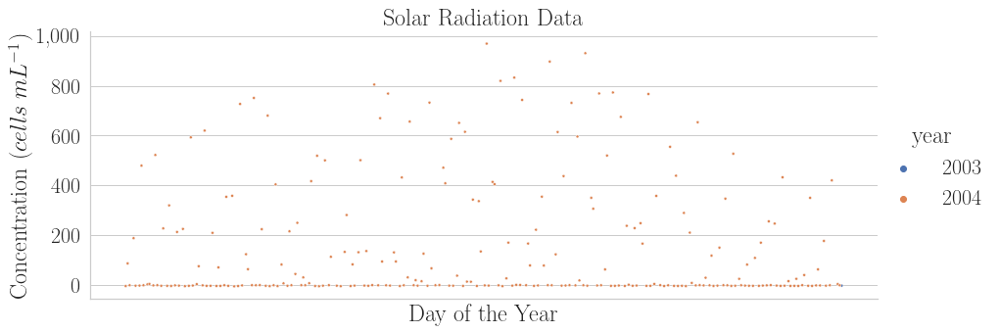

In [61]:
sns.relplot(kind='scatter', data=dfenv[dfenv["year"] <= 2004][::100], x='doy', y='solar', hue='year',
                aspect=2.5,
                marker='.',
               palette = "deep")
plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.StrMethodFormatter('{x:,.0f}')) #adds commas to yaxis tick marks
plt.gca().xaxis.set_major_locator(MonthLocator())  # Tick locator
plt.gca().xaxis.set_major_formatter(DateFormatter('%b'))
plt.xlabel("Day of the Year")
plt.ylabel("Concentration $(cells$ $mL^{-1})$")
plt.title("Solar Radiation Data")

## importing nutrient data



In [78]:
headers = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/mvco_nutrients_headers.csv",header = None)
heads = [str(x)[2:-2] for x in headers.values.tolist()] #converts imported csv into a list so you can rename columns

dfnut = pd.read_csv("/D/MIT-WHOI/github_repos/syn_model/data/mvco_nutrients.csv")
dfnut.columns = heads

dfnut["date"] = pd.to_datetime(dfnut["Start_Date"],format='%Y-%m-%d %H:%M:%S.%f').dt.date#reconverting to date column to datetime format
dfnut["time"] = pd.to_datetime(dfnut["Start_Time_UTC"],format='%Y-%m-%d %H:%M:%S.%f').dt.time#reconverting to date column to datetime format

dfnut["datetime"] = dfnut.apply(lambda r : pd.datetime.combine(r['date'],r['time']),1)
dfnut["month"] = pd.to_datetime(dfnut["datetime"].dt.month,format = "%m") #extracting month
dfnut["doy"] = pd.to_datetime(dfnut["datetime"].dt.dayofyear,format = "%j") #extracting day of year
dfnut["year"] = pd.to_datetime(dfnut["datetime"].dt.year,format = "%Y") #extracting month

dfnut.head()




,Event_Number,Event_Number_Niskin,Start_Date,Start_Time_UTC,Latitude,Longitude,Depth,Nut_a_uM NO2- + NO3-,Nut_b_uM NO2- + NO3-,Nut_c_uM NO2- + NO3-,...,Nut_c_uM SiO2-,Nut_a_uM PO43-,Nut_b_uM PO43-,Nut_c_uM PO43-,date,time,datetime,month,doy,year
0,MVCO_005,MVCO_005_01,2003-06-25 00:00:00.0,1899-12-30 17:55:00.0,41.325,-70.566667,0.0,0.095023,NaN,NaN,...,NaN,0.464469,NaN,NaN,2003-06-25,17:55:00,2003-06-25 17:55:00,1900-06-01,1900-06-25,2003-01-01
1,MVCO_006,MVCO_006_01,2003-07-07 00:00:00.0,1899-12-30 18:10:00.0,41.325,-70.566667,0.0,0.052540,NaN,NaN,...,NaN,0.963674,NaN,NaN,2003-07-07,18:10:00,2003-07-07 18:10:00,1900-07-01,1900-07-07,2003-01-01
2,MVCO_008,MVCO_008_01,2003-07-31 00:00:00.0,1899-12-30 18:15:00.0,41.325,-70.566667,0.0,0.120062,0.115957,NaN,...,NaN,0.267963,0.214370,NaN,2003-07-31,18:15:00,2003-07-31 18:15:00,1900-07-01,1900-07-31,2003-01-01
3,MVCO_009,MVCO_009_01,2003-08-13 00:00:00.0,1899-12-30 17:30:00.0,41.325,-70.566667,0.0,0.000000,0.741919,NaN,...,NaN,0.371178,0.373163,NaN,2003-08-13,17:30:00,2003-08-13 17:30:00,1900-08-01,1900-08-13,2003-01-01
4,MVCO_010,MVCO_010_01,2003-08-15 00:00:00.0,1899-12-30 17:00:00.0,41.325,-70.566667,0.0,0.000000,0.000000,NaN,...,NaN,1.796344,1.468834,NaN,2003-08-15,17:00:00,2003-08-15 17:00:00,1900-08-01,1900-08-15,2003-01-01
